# Validation of Shapes & Cities

@roman

Oct 26, 2024

---
# Settings

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import uuid
import h3
import os
import networkx as nx
from shapely.geometry import Polygon

from INEGIpy import MarcoGeoestadistico

from sklearn.cluster import DBSCAN
from scipy.spatial import KDTree

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [2]:
# Settings
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)
geo_framework = MarcoGeoestadistico()

---
# Data

## Properties

In [3]:
# read parquet
gdf_properties = pd.read_parquet("../../data/interim/cleaned_data_s3.parquet")

# to geodataframe
gdf_properties = gpd.GeoDataFrame(
    gdf_properties,
    geometry=gpd.points_from_xy(gdf_properties['longitude'], gdf_properties['latitude']),
    crs='EPSG:4326'
    )

# look
gdf_properties.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2040882 entries, 0 to 2040881
Data columns (total 53 columns):
 #   Column                              Dtype         
---  ------                              -----         
 0   half_bathrooms                      uint8         
 1   full_bathrooms                      uint8         
 2   property_class_more_common_in_area  string        
 3   neighborhood                        string        
 4   constructor                         string        
 5   zip_code                            uint32        
 6   age_in_months                       uint8         
 7   parking_lots                        uint8         
 8   valuation_date                      datetime64[ns]
 9   potable_water_service_id            float64       
 10  lighting_service_id                 float64       
 11  sidewalk_id                         float64       
 12  project_quality_id                  float64       
 13  property_class_id                 

In [4]:
# look
gdf_properties.head()

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,age_in_months,parking_lots,valuation_date,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,latitude,longitude,level,total_levels,purpose_of_appraisal,bedrooms,built_area,saleable_area,land_area,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,36,1,2022-06-14,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,07,1,NaN,1,2,078,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,16.737283,-92.672659,3,3,S/D,3,216.809998,227.559998,302.700012,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1033417.8,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (-92.67266 16.73728)
1,1,2,4,MAYA,NO APLICA,97134,204,1,2022-11-15,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.014297,-89.575189,3,2,S/D,3,141.550003,154.929993,198.000000,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.0,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430)
2,0,1,3,MULCHECHEN,NO APLICA,97370,192,1,2022-11-01,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,20.916897,-89.580945,3,1,S/D,2,52.049999,54.209999,133.750000,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.0,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690)
3,0,3,4,POBLACION MOTUL,NO APLICA,97430,116,0,2022-11-01,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,052,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,21.096391,-89.285366,3,2,S/D,2,229.929993,248.979996,844.520020,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,641835.2,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (-89.28537 21.09639)
4,1,4,5,LOCALIDAD DE CHABLEKAL,NO APLICA,97302,120,2,2022-11-07,NaN,NaN,NaN,NaN,5,5,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,1,NaN,1,2,050,8765c4c5-2144-413d-bc01-616fdef51316,3,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.097061,-89.618003,3,2,S/D,3,520.500000,674.960022,1200.000000,1.0,NaN,<NA>,17284861.0,17285000.0,8624980.00,5552400.0,<NA>,70,185761da-dc39-4835-86c5-981424f72208,ea19d861-f75b-5ca2-9bd6-177a0c0bd830,POINT (-89.61800 21.09706)


---
# Geographical Clustering

## S0: Get rid of generic coordinates

In [5]:
# eliminate generic coords
gdf_properties = (
    gdf_properties
    .drop_duplicates(subset=['geometry'])
)

# print
print(f"Number of properties: {gdf_properties.shape[0]}")

Number of properties: 1948495


## S1: Define minimum number of points to form a cluster

### DBSCAN Hyperparameters

In [6]:
# from crs 4326 to 6372
gdf_properties = gdf_properties.to_crs('EPSG:6372')

# get lon and lat
gdf_properties['longitude'] = gdf_properties.geometry.x
gdf_properties['latitude'] = gdf_properties.geometry.y

In [7]:
# define function to get poiunts at r distance
def get_neighbors(gdf, r):
    # fit a kdtree
    kdtree = KDTree(
        data=gdf[['longitude', 'latitude']],
    )
    # count neighbors at r-km
    gdf[f'neighbors_{r}km'] = kdtree.query_ball_point(
        gdf[['longitude', 'latitude']],
        r=r * 1_000,
        workers=-1,
        return_length=True
    )
    return gdf

# get neighbors at provided distances
list_distances = [0.1, 0.25, 0.3, 0.4, 0.45, 0.5, 0.75, 1, 1.5, 2]

for r in tqdm(list_distances):
    gdf_properties = get_neighbors(gdf_properties, r)

100%|██████████| 10/10 [00:46<00:00,  4.65s/it]


In [8]:
# get percentil of neighbors at N
def percentil_at_x(x, p):
    return x.gt(p).mean()

# get percentil of neighbors at N
N_MIN_NEIGHBORS = 200

### Different Strategies

In [9]:
# General
(
    gdf_properties
    .filter(like='neighbors')
    .apply(
        lambda x: percentil_at_x(x, N_MIN_NEIGHBORS)
    )
    .sort_values()
)


neighbors_0.1km     0.048410
neighbors_0.25km    0.321675
neighbors_0.3km     0.371423
neighbors_0.4km     0.480155
neighbors_0.45km    0.533038
neighbors_0.5km     0.581965
neighbors_0.75km    0.757449
neighbors_1km       0.853241
neighbors_1.5km     0.927700
neighbors_2km       0.952594
dtype: float64

In [10]:
# look percentiles
for p in [20, 30, 50, 75, 100, 200, 300]:
    print(
        f"Percentil at {p} {'=' * 10} \n",
        (
            gdf_properties
            .filter(like='neighbors')
            .apply(
                lambda x: percentil_at_x(x, p)
            )
            .sort_values()
        )
    )

Percentil at 20 ========== 
 neighbors_0.1km     0.546776
neighbors_0.25km    0.858136
neighbors_0.3km     0.895375
neighbors_0.4km     0.937607
neighbors_0.45km    0.949744
neighbors_0.5km     0.958252
neighbors_0.75km    0.978048
neighbors_1km       0.985074
neighbors_1.5km     0.990184
neighbors_2km       0.992190
dtype: float64
Percentil at 30 ========== 
 neighbors_0.1km     0.460684
neighbors_0.25km    0.792657
neighbors_0.3km     0.842385
neighbors_0.4km     0.903201
neighbors_0.45km    0.921886
neighbors_0.5km     0.935691
neighbors_0.75km    0.967915
neighbors_1km       0.978747
neighbors_1.5km     0.986658
neighbors_2km       0.989547
dtype: float64
Percentil at 50 ========== 
 neighbors_0.1km     0.374588
neighbors_0.25km    0.678649
neighbors_0.3km     0.747893
neighbors_0.4km     0.836305
neighbors_0.45km    0.865695
neighbors_0.5km     0.888181
neighbors_0.75km    0.946612
neighbors_1km       0.966222
neighbors_1.5km     0.979848
neighbors_2km       0.984750
dtype: float6

In [11]:
# now see it at state level
(
    gdf_properties
    .groupby('state_id')
    .apply(
        lambda x: x.filter(like='neighbors').apply(
            lambda x: percentil_at_x(x, 30)
        )
    )
    .T
    .sort_index()
    .style.format("{:.0%}")
)

/var/folders/42/2lkg1sf91wv7mjxw6klfcqtc0000gn/T/ipykernel_22798/4242324456.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(


state_id,01,02,03,04,05,06,07,08,09,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32
neighbors_0.1km,59%,29%,33%,12%,42%,40%,30%,42%,37%,38%,48%,28%,64%,48%,43%,37%,44%,42%,61%,21%,43%,59%,68%,42%,46%,40%,21%,44%,26%,27%,54%,49%
neighbors_0.25km,89%,57%,66%,45%,79%,81%,57%,81%,81%,77%,81%,67%,83%,84%,84%,72%,73%,76%,90%,43%,75%,90%,90%,82%,80%,76%,43%,79%,46%,60%,68%,74%
neighbors_0.3km,92%,65%,73%,60%,85%,86%,64%,86%,88%,83%,85%,72%,86%,88%,88%,77%,78%,81%,93%,47%,81%,93%,93%,87%,86%,82%,49%,85%,51%,66%,75%,79%
neighbors_0.45km,97%,81%,86%,79%,94%,93%,78%,95%,96%,94%,93%,82%,91%,94%,94%,88%,89%,91%,98%,57%,90%,97%,97%,95%,94%,91%,66%,93%,66%,80%,88%,89%
neighbors_0.4km,96%,77%,82%,75%,92%,92%,74%,93%,94%,92%,91%,80%,90%,93%,93%,85%,86%,89%,97%,53%,88%,96%,96%,93%,92%,89%,60%,92%,61%,76%,85%,86%
neighbors_0.5km,98%,85%,89%,82%,96%,95%,81%,96%,97%,95%,94%,84%,92%,95%,95%,89%,91%,93%,98%,62%,92%,97%,97%,95%,95%,93%,70%,95%,70%,83%,91%,90%
neighbors_0.75km,99%,92%,95%,91%,98%,97%,91%,98%,99%,97%,97%,92%,95%,98%,97%,95%,95%,96%,99%,75%,95%,99%,99%,97%,98%,97%,82%,98%,83%,90%,96%,95%
neighbors_1.5km,100%,98%,98%,96%,100%,99%,96%,99%,100%,98%,99%,96%,98%,99%,99%,98%,99%,98%,100%,90%,98%,100%,100%,99%,99%,99%,91%,99%,95%,94%,98%,97%
neighbors_1km,100%,96%,97%,94%,99%,98%,94%,99%,100%,98%,98%,94%,96%,98%,98%,96%,97%,97%,100%,84%,97%,99%,99%,98%,99%,98%,87%,99%,90%,93%,97%,96%
neighbors_2km,100%,99%,98%,97%,100%,99%,96%,99%,100%,99%,99%,97%,98%,99%,99%,98%,99%,98%,100%,92%,99%,100%,100%,99%,99%,99%,93%,99%,96%,95%,99%,98%


## S2: Cluster Points Within M meters

In [12]:
# use dbscan to cluster
eps = 300  # m meters of distance
min_samples = 30  # n points to consider a cluster

# get the clusters
dbscan = DBSCAN(eps=eps, min_samples=min_samples)
gdf_properties['cluster'] = dbscan.fit_predict(gdf_properties[['longitude', 'latitude']])

In [13]:
# identify the isolated points
print(gdf_properties['cluster'].eq(-1).mean())
print(gdf_properties['cluster'].eq(-1).sum())

0.09559737130451965
186271


<Axes: >

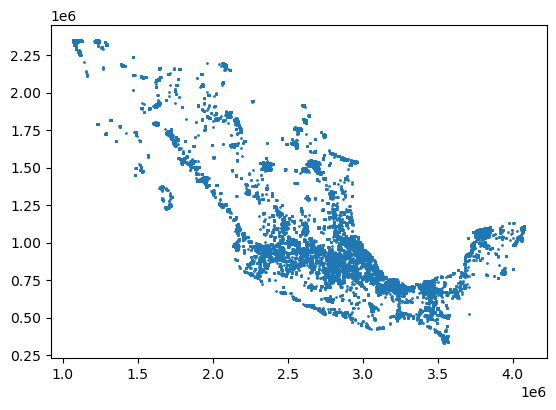

In [14]:
# plot isolated points
gdf_properties[gdf_properties['cluster'].eq(-1)].plot(markersize=1)

In [15]:
# count clusters
gdf_properties['cluster'].nunique()

3496

<Axes: >

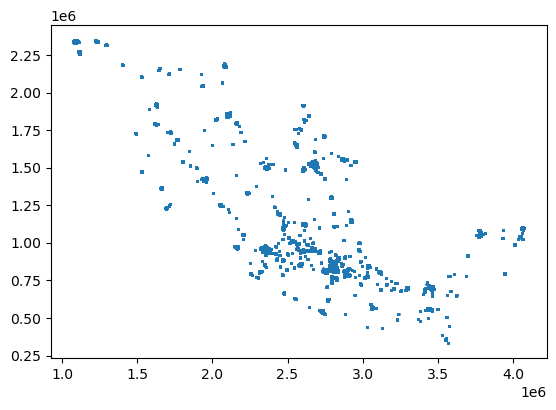

In [16]:
# plot no-isolated points
gdf_properties[gdf_properties['cluster'].ne(-1)].plot(markersize=1)

In [17]:
# for state_id = 09 look at the isolated points
(
    gdf_properties
    .query('state_id == "09"')
    .assign(isolated=lambda x: x['cluster'].eq(-1))
    .loc[:, ['geometry', 'neighborhood', 'isolated']]
    .sample(10_000)
    .explore('isolated', tiles='cartodbpositron')
)

---
# Cities Creation

## S1: Raw Cities

In [18]:
# subset the data
gdf_properties = gdf_properties[gdf_properties['cluster'].ne(-1)]

# print size
print(f"Number of properties: {gdf_properties.shape[0]}")

Number of properties: 1762224


In [19]:
# table of properties per cluster
tbl_properties_per_cluster = (
    gdf_properties
    .groupby('cluster')
    .size()
    .reset_index(name='properties')
    .sort_values('properties', ascending=False, ignore_index=True)
)

# look
tbl_properties_per_cluster

,cluster,properties
0,355,66372
1,85,25304
2,163,21812
3,203,19895
4,128,18528
...,...,...
3490,3414,9
3491,3443,9
3492,3406,8
3493,3470,8


In [20]:
# see num props
tbl_properties_per_cluster['properties'].sum()

1762224

In [21]:
# get convex hull of each cluster
gdf_cities_raw = (
    gdf_properties
    .dissolve(by='cluster')
    .reset_index()
    .assign(
        geometry=lambda x: x['geometry'].convex_hull
    )
    # join with tbl
    .merge(
        tbl_properties_per_cluster,
        on='cluster',
        how='left'
    )
    .loc[:, ['cluster', 'geometry', 'state_id', 'municipality_id', 'properties']]
)
# look
print(gdf_cities_raw.shape)
gdf_cities_raw.head()

(3495, 5)


,cluster,geometry,state_id,municipality_id,properties
0,0,"POLYGON ((3785383.781 1054794.370, 3784042.753...",31,050,683
1,1,"POLYGON ((3784189.289 1044967.272, 3784046.380...",31,041,504
2,2,"POLYGON ((3789352.948 1050148.462, 3788726.745...",31,041,1274
3,3,"POLYGON ((2098434.995 1848325.035, 2098135.691...",08,019,11744
4,4,"POLYGON ((3779167.375 1059754.887, 3779102.379...",31,050,304


In [22]:
# see num properties
gdf_cities_raw['properties'].sum()

1762224

In [23]:
# properties with nan
gdf_cities_raw['properties'].isna().sum()

0

In [24]:
# convex hull of each cluster
gdf_cities_raw.explore(tiles='cartodbpositron')

In [25]:
# delete gdf_properties to save memory
del gdf_properties

## S2: Pooling Clusters

### Pooling

In [26]:
# functions
def create_graph_of_cities_intersections(gdf):
    # Step 1: Initialize an empty graph
    G = nx.Graph()

    # Step 2: Add nodes (geometries) to the graph
    print(f"Adding nodes to the graph...")
    for i, geom in tqdm(enumerate(gdf.geometry)):
        G.add_node(i, geometry=geom)

    # Step 3: Add edges for intersections
    print(f"Adding edges to the graph...")
    for i in tqdm(range(len(gdf))):
        for j in range(i+1, len(gdf)):
            if gdf.geometry[i].intersects(gdf.geometry[j]):
                G.add_edge(i, j)
    return G


def clusters_pooling_from_graph(G, df):
    # Step 1: Find connected components (intersections)
    print(f"Finding connected components...")
    connected_components = list(nx.connected_components(G))

    # Step 2: Create dataframes for each cluster
    list_clusters = []
    for i, cluster in enumerate(connected_components):
        df_cluster = df.iloc[list(cluster)].copy()
        df_cluster['new_cluster'] = i
        list_clusters.append(df_cluster)

    # Step 3: Merge all clusters into a single dataframe
    df_clusters = pd.concat(list_clusters)
    df_clusters = df_clusters[['new_cluster', 'cluster']]

    return df_clusters

In [27]:
# buffer
# meters to buffer
METERS_BUFFER = 2_500

# buffer cities
gdf_cities_raw_buffed = (
    gdf_cities_raw
    .copy()
    # buffer
    .assign(geometry=lambda x: x.buffer(METERS_BUFFER))
)

# see buffered data
gdf_cities_raw_buffed.explore(tiles='cartodb positron')

Adding nodes to the graph...


3495it [00:00, 344102.07it/s]


Adding edges to the graph...


100%|██████████| 3495/3495 [02:32<00:00, 22.98it/s] 


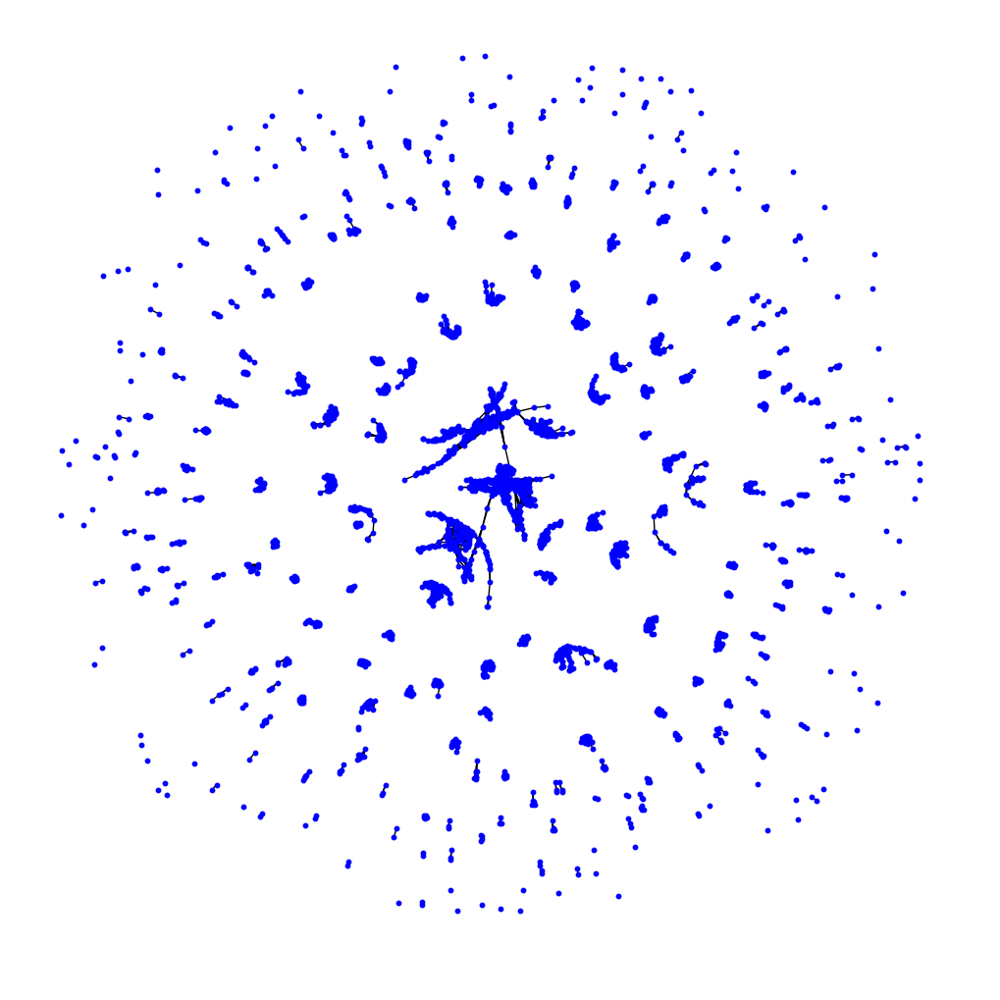

In [42]:
# create graph
G_cities_raw = create_graph_of_cities_intersections(gdf_cities_raw_buffed)

# see the graph
# see the graph
plt.figure(figsize=(10, 10))
nx.draw(G_cities_raw, node_size=10, node_color='blue', with_labels=False)
plt.show()

In [43]:
# pooling
df_clusters = clusters_pooling_from_graph(G_cities_raw, gdf_cities_raw)

# merge
gdf_cities_pooled = (
    gdf_cities_raw
    .merge(df_clusters, on='cluster')
    .dissolve(by='new_cluster', aggfunc='sum')
    .reset_index()
    .loc[:, ['new_cluster', 'properties', 'geometry']]
)

# look
gdf_cities_pooled

Finding connected components...


,new_cluster,properties,geometry
0,0,42955,"MULTIPOLYGON (((3766613.839 1040041.179, 37666..."
1,1,38201,"MULTIPOLYGON (((2093658.150 1842699.728, 20945..."
2,2,47606,"MULTIPOLYGON (((2077038.721 2177846.642, 20770..."
3,3,4532,"MULTIPOLYGON (((3695844.334 914490.256, 369584..."
4,4,210880,"MULTIPOLYGON (((2656880.287 1512686.187, 26569..."
...,...,...,...
326,326,31,"POLYGON ((2155002.804 1167395.420, 2154789.931..."
327,327,30,"POLYGON ((1568964.111 1582365.280, 1568911.461..."
328,328,31,"POLYGON ((2838178.292 1580245.333, 2838194.147..."
329,329,30,"POLYGON ((2200944.784 1028301.056, 2200656.605..."


### Validate

In [44]:
# validate
print(f"Number of properties: {gdf_cities_pooled['properties'].sum()}")
print(f"Number of clusters: {gdf_cities_pooled.shape[0]}")

Number of properties: 1762224
Number of clusters: 331


In [45]:
# see
gdf_cities_pooled.explore('new_cluster', tiles='cartodbpositron')

In [46]:
# see clusters with less than N properties
N_MINIMUM = 1000

print(f"Clusters with less than {N_MINIMUM} properties: {gdf_cities_pooled['properties'].lt(N_MINIMUM).mean()}")
(
    gdf_cities_pooled
    .assign(
        min_properties=lambda x: x['properties'].lt(N_MINIMUM)
    )
    .explore('min_properties', tiles='cartodb positron', cmap='viridis')
)

Clusters with less than 1000 properties: 0.6465256797583081


## S3: Eliminate Cities with Few Properties

In [47]:
# get rid of clusters with less than N properties
gdf_cities_subset = (
    gdf_cities_pooled
    .query('properties >= @N_MINIMUM')
    .copy()
    .reset_index(drop=True)
    .assign(cluster=lambda x: x.index)
    .drop(columns=['new_cluster'])
    )
# look size
print(gdf_cities_subset.shape)
gdf_cities_subset.sort_values('properties', ascending=False).head()

(117, 3)


,properties,geometry,cluster
10,219323,"MULTIPOLYGON (((2788063.668 818047.414, 278810...",10
4,210880,"MULTIPOLYGON (((2656880.287 1512686.187, 26569...",4
11,130307,"MULTIPOLYGON (((2343319.313 940112.955, 234322...",11
7,71484,"MULTIPOLYGON (((2656179.527 947758.700, 265623...",7
2,47606,"MULTIPOLYGON (((2077038.721 2177846.642, 20770...",2


In [48]:
# see how many properties we have in each cluster
gdf_cities_subset['properties'].sum()

1709009

In [49]:
# create convex hull
gdf_cities_subset['geometry'] = gdf_cities_subset.convex_hull

# plot
gdf_cities_subset.explore(tiles='cartodb positron')

## S4: Gather Mini Clusters

In [56]:
# Step 0: Buffer
BUFFER_METERS = 2_000
gdf_cities_final_raw = gdf_cities_subset.copy()
gdf_cities_final_raw_buffered = gdf_cities_final_raw.copy().assign(geometry=lambda x: x.buffer(BUFFER_METERS))

# Step 1: Create graph
G_cities = create_graph_of_cities_intersections(gdf_cities_final_raw_buffered)

# Step 2: Pool clusters
df_clusters = clusters_pooling_from_graph(G_cities, gdf_cities_final_raw)

# Step 3: Merge
gdf_cities = (
    gdf_cities_final_raw
    .merge(df_clusters, on='cluster')
    .dissolve(by='new_cluster', aggfunc='sum')
    .reset_index()
    .loc[:, ['new_cluster', 'geometry']]
    .assign(geometry=lambda x: x.convex_hull)
    .reset_index(drop=True)
    .assign(cluster=lambda x: x.index)
    .drop(columns=['new_cluster'])
    .assign(geometry=lambda x: x.buffer(1_000))
)

# see
gdf_cities

Adding nodes to the graph...


117it [00:00, 66748.31it/s]


Adding edges to the graph...


100%|██████████| 117/117 [00:00<00:00, 422.76it/s]


Finding connected components...


,geometry,cluster
0,"POLYGON ((3766192.137 1038920.719, 3766072.241...",0
1,"POLYGON ((2106201.674 1838908.292, 2106105.496...",1
2,"POLYGON ((2083964.935 2167068.796, 2083854.591...",2
3,"POLYGON ((3695976.760 913468.113, 3695883.500 ...",3
4,"POLYGON ((2691489.214 1478562.321, 2691414.834...",4
...,...,...
109,"POLYGON ((2809075.793 1188762.402, 2808986.206...",109
110,"POLYGON ((2652237.387 1032197.642, 2652132.900...",110
111,"POLYGON ((2608508.314 1013348.771, 2608407.574...",111
112,"POLYGON ((2401691.811 1520986.348, 2401617.754...",112


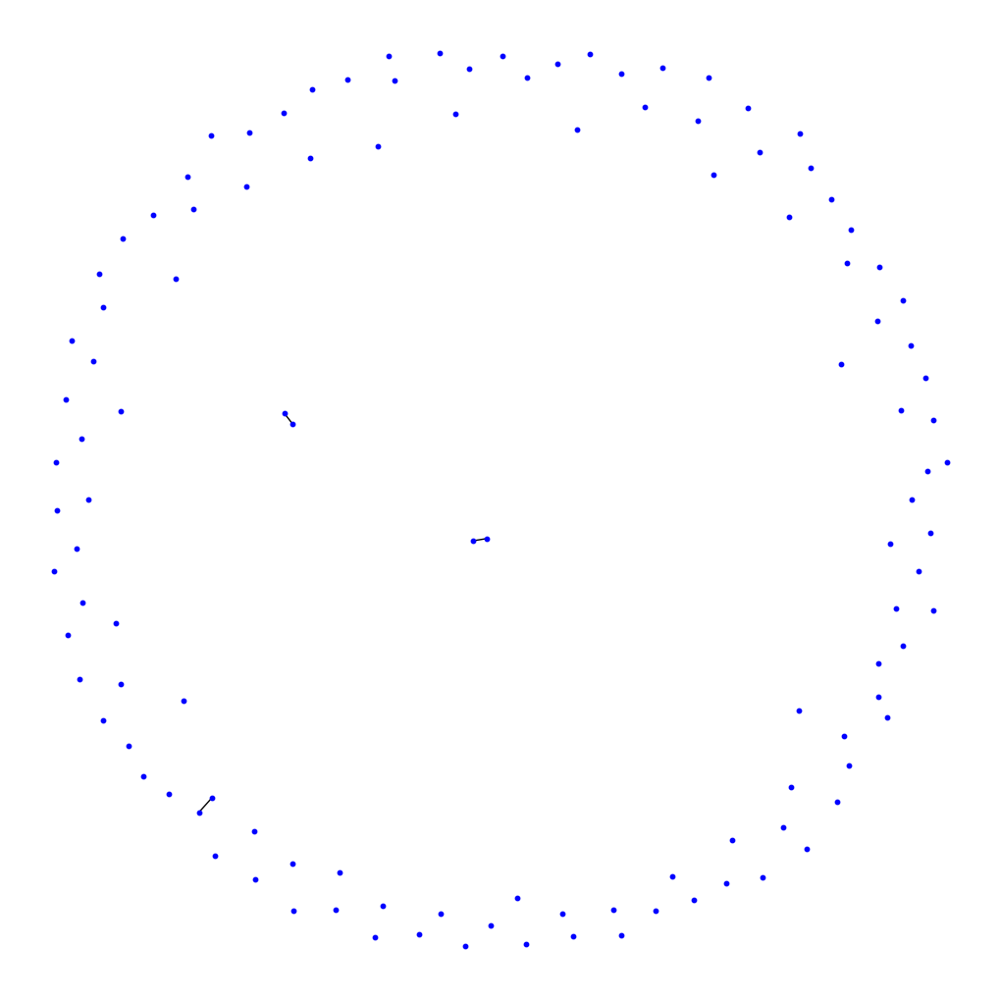

In [57]:
# see grap
plt.figure(figsize=(10, 10))
nx.draw(G_cities, node_size=10, node_color='blue', with_labels=False)
plt.show()

In [58]:
# see
gdf_cities.explore('cluster', tiles='cartodbpositron')

## S5: Decorate Info

In [12]:
gdf_cities = gpd.read_parquet("../../data/misc/cities.parquet").drop(columns=['total_properties'])
gdf_cities

,geometry,cluster
0,"POLYGON ((3766192.137 1038920.719, 3766072.241...",0
1,"POLYGON ((2106201.674 1838908.292, 2106105.496...",1
2,"POLYGON ((2083964.935 2167068.796, 2083854.591...",2
3,"POLYGON ((3695976.760 913468.113, 3695883.500 ...",3
4,"POLYGON ((2691489.214 1478562.321, 2691414.834...",4
...,...,...
109,"POLYGON ((2809075.793 1188762.402, 2808986.206...",109
110,"POLYGON ((2652237.387 1032197.642, 2652132.900...",110
111,"POLYGON ((2608508.314 1013348.771, 2608407.574...",111
112,"POLYGON ((2401691.811 1520986.348, 2401617.754...",112


In [13]:
# read parquet
gdf_properties = (
    pd.read_parquet("../../data/interim/cleaned_data_s3.parquet")
    .assign(
        geometry=lambda x: gpd.points_from_xy(x.longitude, x.latitude)
    )
    .pipe(gpd.GeoDataFrame, crs='EPSG:4326')
    # .drop(columns=['latitude', 'longitude'])
    .assign(
        state_id=lambda x: x['state_id'].astype(str).str.zfill(2),
        municipality_id=lambda x: x['municipality_id'].astype(str).str.zfill(3)
    )
)
# see
print(gdf_properties.shape)
gdf_properties.head()


(2040882, 53)


,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,age_in_months,parking_lots,valuation_date,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,latitude,longitude,level,total_levels,purpose_of_appraisal,bedrooms,built_area,saleable_area,land_area,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,36,1,2022-06-14,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,07,1,NaN,1,2,078,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,16.737283,-92.672659,3,3,S/D,3,216.809998,227.559998,302.700012,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1033417.8,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (-92.67266 16.73728)
1,1,2,4,MAYA,NO APLICA,97134,204,1,2022-11-15,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.014297,-89.575189,3,2,S/D,3,141.550003,154.929993,198.000000,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.0,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430)
2,0,1,3,MULCHECHEN,NO APLICA,97370,192,1,2022-11-01,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,20.916897,-89.580945,3,1,S/D,2,52.049999,54.209999,133.750000,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.0,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690)
3,0,3,4,POBLACION MOTUL,NO APLICA,97430,116,0,2022-11-01,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,052,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,21.096391,-89.285366,3,2,S/D,2,229.929993,248.979996,844.520020,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,641835.2,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (-89.28537 21.09639)
4,1,4,5,LOCALIDAD DE CHABLEKAL,NO APLICA,97302,120,2,2022-11-07,NaN,NaN,NaN,NaN,5,5,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,1,NaN,1,2,050,8765c4c5-2144-413d-bc01-616fdef51316,3,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.097061,-89.618003,3,2,S/D,3,520.500000,674.960022,1200.000000,1.0,NaN,<NA>,17284861.0,17285000.0,8624980.00,5552400.0,<NA>,70,185761da-dc39-4835-86c5-981424f72208,ea19d861-f75b-5ca2-9bd6-177a0c0bd830,POINT (-89.61800 21.09706)


In [14]:
# join properties with cities
gdf_properties_in_cities = (
    gdf_properties
    .loc[:, ['observation_id', 'geometry']]
    .to_crs('EPSG:6372')
    .sjoin(
        gdf_cities[['cluster', 'geometry']],
        predicate='within',
        how='left'
    )
    .drop(columns='index_right')
)

# see
gdf_properties_in_cities

,observation_id,geometry,cluster
0,02086af7-ffbb-4e67-b857-27e6cef09b0d,POINT (3495349.900 560385.314),NaN
1,43c375b2-75fd-4fcc-b311-55b396e7cbbf,POINT (3784284.380 1056168.461),0.0
2,f95c14fe-9acc-4b5c-872b-bd15d412a65d,POINT (3784619.353 1045421.310),0.0
3,74af41d9-b7b3-464d-9302-7fd1f231ee26,POINT (3813363.000 1067806.582),NaN
4,185761da-dc39-4835-86c5-981424f72208,POINT (3779083.399 1064873.781),0.0
...,...,...,...
2040877,caf91174-0dfb-4003-9df5-170d8d639527,POINT (2473735.080 1103198.523),17.0
2040878,eb82f104-b1a9-4adb-a1bb-e694897732bb,POINT (2473735.080 1103198.523),17.0
2040879,9eda18ef-854e-471f-94d1-f2182c5b9067,POINT (2353963.470 971392.022),11.0
2040880,4bb30eb3-2af0-45a2-baf7-4aa84d6bfdee,POINT (2788804.234 880799.645),52.0


In [15]:
# how many properties are in cities
print(gdf_properties_in_cities['cluster'].notnull().mean())
print(gdf_properties_in_cities['cluster'].notnull().sum())

0.9358497943536177
1909959


In [16]:
# see how many properties are in each cluster
tbl_properties = (
    gdf_properties_in_cities
    .groupby('cluster')
    .size()
    .reset_index(name='total_properties')
    .sort_values('total_properties', ascending=False)
)
tbl_properties

,cluster,total_properties
10,10.0,255034
4,4.0,224732
11,11.0,149037
7,7.0,76606
2,2.0,49914
...,...,...
79,79.0,1255
112,112.0,1189
94,94.0,1174
100,100.0,1164


In [17]:
# join counts with cities
gdf_cities_final = (
    gdf_cities
    .merge(tbl_properties, on='cluster', how='left')
)
gdf_cities_final

,geometry,cluster,total_properties
0,"POLYGON ((3766192.137 1038920.719, 3766072.241...",0,49294
1,"POLYGON ((2106201.674 1838908.292, 2106105.496...",1,41078
2,"POLYGON ((2083964.935 2167068.796, 2083854.591...",2,49914
3,"POLYGON ((3695976.760 913468.113, 3695883.500 ...",3,4945
4,"POLYGON ((2691489.214 1478562.321, 2691414.834...",4,224732
...,...,...,...
109,"POLYGON ((2809075.793 1188762.402, 2808986.206...",109,1570
110,"POLYGON ((2652237.387 1032197.642, 2652132.900...",110,1158
111,"POLYGON ((2608508.314 1013348.771, 2608407.574...",111,1402
112,"POLYGON ((2401691.811 1520986.348, 2401617.754...",112,1189


In [18]:
# see
gdf_cities_final['total_properties'].sort_values(ascending=False)

10     255034
4      224732
11     149037
7       76606
2       49914
        ...  
79       1255
112      1189
94       1174
100      1164
110      1158
Name: total_properties, Length: 114, dtype: int64

In [19]:
# see how many cities have less than 1000 properties
print(gdf_cities_final['total_properties'].lt(1000).sum())

0


count       114.000000
mean      16754.026316
std       35698.810052
min        1158.000000
25%        2080.250000
50%        5130.500000
75%       14545.250000
max      255034.000000
Name: total_properties, dtype: float64


<Axes: xlabel='total_properties', ylabel='Count'>

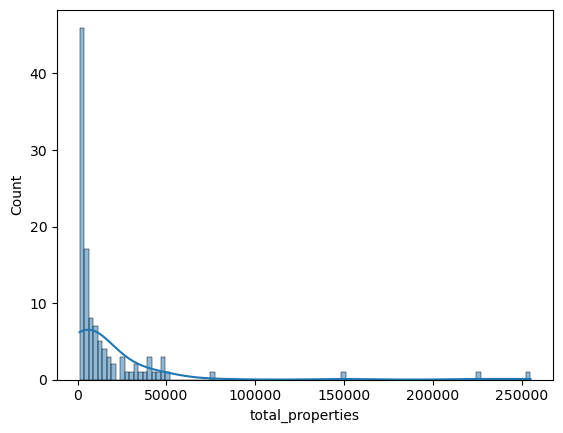

In [20]:
# distribution of properties
print(gdf_cities_final['total_properties'].describe())
sns.histplot(gdf_cities_final['total_properties'], bins=100, kde=True)

In [21]:
# plot
(
    gdf_cities_final
    .explore('total_properties', tiles='cartodb positron', cmap='viridis')
    )

---
# Save

## Cities

In [75]:
# save cities
gdf_cities_final.to_parquet("../../data/misc/cities.parquet")

## Properties

In [22]:
# save properties in cities
gdf_properties_final = (
    gdf_properties
    .merge(
        gdf_properties_in_cities.drop(columns='geometry').dropna(subset=['cluster']),
        on='observation_id',
        how='inner'
    )
    .rename(columns={'cluster': 'city_cluster'})
    # cluster astype uint8
    .astype({'city_cluster': 'uint16'})
)

gdf_properties_final.shape

(1909959, 54)

In [23]:
# count observations
gdf_properties_final['observation_id'].nunique()

1909959

In [24]:
# info
gdf_properties_final.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1909959 entries, 0 to 1909958
Data columns (total 54 columns):
 #   Column                              Dtype         
---  ------                              -----         
 0   half_bathrooms                      uint8         
 1   full_bathrooms                      uint8         
 2   property_class_more_common_in_area  string        
 3   neighborhood                        string        
 4   constructor                         string        
 5   zip_code                            uint32        
 6   age_in_months                       uint8         
 7   parking_lots                        uint8         
 8   valuation_date                      datetime64[ns]
 9   potable_water_service_id            float64       
 10  lighting_service_id                 float64       
 11  sidewalk_id                         float64       
 12  project_quality_id                  float64       
 13  property_class_id                 

In [25]:
# save
os.makedirs("../../data/interim", exist_ok=True)
gdf_properties_final.drop(columns='geometry').to_parquet("../../data/interim/cleaned_data_s4.parquet")

---
# Sandbox

In [40]:
df_clusters

,new_cluster,cluster
0,0,0
1,1,1
2,2,2
99,3,99
74,3,74
...,...,...
325,309,325
326,310,326
327,311,327
328,312,328


In [26]:
gdf_properties_final

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,age_in_months,parking_lots,valuation_date,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,latitude,longitude,level,total_levels,purpose_of_appraisal,bedrooms,built_area,saleable_area,land_area,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry,city_cluster
0,1,2,4,MAYA,NO APLICA,97134,204,1,2022-11-15,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.014297,-89.575189,3,2,S/D,3,141.550003,154.929993,198.000000,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.00,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430),0
1,0,1,3,MULCHECHEN,NO APLICA,97370,192,1,2022-11-01,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,20.916897,-89.580945,3,1,S/D,2,52.049999,54.209999,133.750000,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.00,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690),0
2,1,4,5,LOCALIDAD DE CHABLEKAL,NO APLICA,97302,120,2,2022-11-07,NaN,NaN,NaN,NaN,5,5,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,1,NaN,1,2,050,8765c4c5-2144-413d-bc01-616fdef51316,3,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.097061,-89.618003,3,2,S/D,3,520.500000,674.960022,1200.000000,1.0,NaN,<NA>,17284861.0,17285000.0,8624980.00,5552400.00,<NA>,70,185761da-dc39-4835-86c5-981424f72208,ea19d861-f75b-5ca2-9bd6-177a0c0bd830,POINT (-89.61800 21.09706),0
3,1,2,3,FRACCIONAMIENTO AMANECERES,NO PROPORCIONADO,97370,0,1,2022-11-16,NaN,NaN,NaN,NaN,3,6,8b6705bf-3b28-4a0c-8e1e-564dc7d09cf3,0.0,31,1,NaN,1,3,041,b6ec5872-8e1c-4a3e-908f-5dc1ab822e5b,4,NaN,NaN,NaN,2,NaN,7ffc29d8-5fe3-4c98-8570-5e5027bdd604,82a61e5f-2755-4cd2-9c60-96d1859009dd,20.961569,-89.529486,3,1,S/D,2,111.629997,111.629997,181.699997,1.0,NaN,<NA>,1183300.0,1183000.0,837225.00,199870.00,<NA>,60,4e2c4e1a-e759-48ab-a4f6-2d1dbc6f55da,d71ff72e-16ad-5c47-be4b-7c6faf2e9225,POINT (-89.52949 20.96157),0
4,0,2,4,MERIDA,NO APLICA,97206,240,1,2022-11-23,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,b6ec5872-8e1c-4a3e-908f-5dc1ab822e5b,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.015836,-89.654367,3,1,S/D,3,103.570000,138.380005,364.000000,1.0,NaN,<NA>,1878072.0,1878000.0,762310.40,948518.48,<NA>,50,d51a3c97-180f-453a-8364-800116e0bfd6,5b145754-3253-589b-8de7-cab1f74fdde3,POINT (-89.65437 21.01584),0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1909954,0,1,3,VILLA MONTAÑA,CASAS JAVER,20126,0,1,2019-09-23,NaN,NaN,NaN,NaN,3,6,e93a5424-1395-46f9-b5a0-beb13168a63a,2.0,01,3,NaN,3,6,001,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,3,NaN,b0f0a7b0-0630-4d98-901d-15e8f2bbce01,fb07d004-2bdf-44f3-8dac-4341ecbd40b8,21.946051,-102.255550,4,1,S/D,2,43.980000,43.980000,45.000000,NaN,NaN,<NA>,344789.0,345000.0,224298.00,72495.00,<NA>,60,caf91174-0dfb-4003-9df5-170d8d639527,fff